In [157]:
import numpy as np
import torch
import torchvision.transforms as transforms
import torchvision.datasets as dset
import torchvision.utils as vutils
import torch.nn as nn
import torch.optim as optim
import matplotlib.animation as animation
import matplotlib.pyplot as plt
import glob
from PIL import Image
from IPython.display import HTML


SyntaxError: invalid syntax (<ipython-input-157-53bac3101005>, line 13)

In [179]:
dataroot = 'sentences'
workers = 2
batch_size = 3
image_size = 64
nz = 100
nc = 3
ngf = 64
ndf = 64
num_epochs = 10
lr = 0.0002
beta1 = 0.5
ngpu = 1


In [180]:
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
dataset


Dataset ImageFolder
    Number of datapoints: 16752
    Root location: sentences
    StandardTransform
Transform: Compose(
               Resize(size=64, interpolation=PIL.Image.BILINEAR)
               CenterCrop(size=(64, 64))
               ToTensor()
               Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
           )

In [181]:
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

In [182]:
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

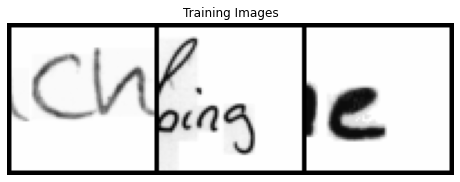

In [183]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [184]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [185]:
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [186]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [187]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [188]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [189]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [190]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/10][0/5584]	Loss_D: 1.8552	Loss_G: 10.8377	D(x): 0.4668	D(G(z)): 0.5374 / 0.0001
[0/10][50/5584]	Loss_D: 3.9143	Loss_G: 1.6103	D(x): 0.2293	D(G(z)): 0.0001 / 0.2547
[0/10][100/5584]	Loss_D: 0.3559	Loss_G: 7.6047	D(x): 0.9999	D(G(z)): 0.2215 / 0.0006
[0/10][150/5584]	Loss_D: 0.0597	Loss_G: 8.4393	D(x): 0.9853	D(G(z)): 0.0420 / 0.0007
[0/10][200/5584]	Loss_D: 0.8627	Loss_G: 2.1045	D(x): 0.6565	D(G(z)): 0.0068 / 0.2755
[0/10][250/5584]	Loss_D: 0.2035	Loss_G: 4.5308	D(x): 0.8433	D(G(z)): 0.0043 / 0.0147
[0/10][300/5584]	Loss_D: 0.2257	Loss_G: 7.3585	D(x): 0.8322	D(G(z)): 0.0051 / 0.0030
[0/10][350/5584]	Loss_D: 0.0287	Loss_G: 8.2723	D(x): 0.9742	D(G(z)): 0.0025 / 0.0003
[0/10][400/5584]	Loss_D: 0.1880	Loss_G: 3.1250	D(x): 0.8917	D(G(z)): 0.0591 / 0.0719
[0/10][450/5584]	Loss_D: 0.6917	Loss_G: 10.2140	D(x): 0.8822	D(G(z)): 0.3840 / 0.0001
[0/10][500/5584]	Loss_D: 0.5684	Loss_G: 2.6153	D(x): 0.6281	D(G(z)): 0.0100 / 0.1005
[0/10][550/5584]	Loss_D: 0.3008	Loss_G: 

[0/10][4800/5584]	Loss_D: 0.7347	Loss_G: 6.3888	D(x): 0.9932	D(G(z)): 0.4800 / 0.0020
[0/10][4850/5584]	Loss_D: 0.0283	Loss_G: 5.0415	D(x): 0.9791	D(G(z)): 0.0069 / 0.0072
[0/10][4900/5584]	Loss_D: 0.2503	Loss_G: 3.0913	D(x): 0.9974	D(G(z)): 0.1845 / 0.0893
[0/10][4950/5584]	Loss_D: 0.9573	Loss_G: 1.6413	D(x): 0.7674	D(G(z)): 0.4459 / 0.1962
[0/10][5000/5584]	Loss_D: 0.3865	Loss_G: 3.9863	D(x): 0.8900	D(G(z)): 0.2091 / 0.0366
[0/10][5050/5584]	Loss_D: 0.2855	Loss_G: 5.0434	D(x): 0.9863	D(G(z)): 0.1925 / 0.0097
[0/10][5100/5584]	Loss_D: 0.2156	Loss_G: 4.4718	D(x): 0.8286	D(G(z)): 0.0227 / 0.0130
[0/10][5150/5584]	Loss_D: 0.1102	Loss_G: 2.9169	D(x): 0.9894	D(G(z)): 0.0936 / 0.0612
[0/10][5200/5584]	Loss_D: 1.5999	Loss_G: 6.0782	D(x): 0.2969	D(G(z)): 0.0006 / 0.0026
[0/10][5250/5584]	Loss_D: 1.9216	Loss_G: 1.0829	D(x): 0.4507	D(G(z)): 0.2509 / 0.3520
[0/10][5300/5584]	Loss_D: 0.3053	Loss_G: 1.2636	D(x): 0.9345	D(G(z)): 0.2053 / 0.2843
[0/10][5350/5584]	Loss_D: 0.0942	Loss_G: 3.6522	D(x): 

[1/10][4000/5584]	Loss_D: 0.1105	Loss_G: 3.0333	D(x): 0.9430	D(G(z)): 0.0500 / 0.0581
[1/10][4050/5584]	Loss_D: 0.8618	Loss_G: 1.3954	D(x): 0.5242	D(G(z)): 0.1726 / 0.2534
[1/10][4100/5584]	Loss_D: 0.1246	Loss_G: 3.7388	D(x): 0.8944	D(G(z)): 0.0108 / 0.0238
[1/10][4150/5584]	Loss_D: 1.7046	Loss_G: 3.1508	D(x): 0.2872	D(G(z)): 0.0250 / 0.0727
[1/10][4200/5584]	Loss_D: 0.8480	Loss_G: 2.9547	D(x): 0.8561	D(G(z)): 0.4773 / 0.0549
[1/10][4250/5584]	Loss_D: 0.7796	Loss_G: 1.8127	D(x): 0.5392	D(G(z)): 0.0290 / 0.1943
[1/10][4300/5584]	Loss_D: 0.8150	Loss_G: 3.9381	D(x): 0.6036	D(G(z)): 0.0179 / 0.0247
[1/10][4350/5584]	Loss_D: 1.2324	Loss_G: 2.3641	D(x): 0.4117	D(G(z)): 0.1078 / 0.2060
[1/10][4400/5584]	Loss_D: 0.5828	Loss_G: 1.4980	D(x): 0.6880	D(G(z)): 0.1702 / 0.2562
[1/10][4450/5584]	Loss_D: 1.1986	Loss_G: 1.0557	D(x): 0.3426	D(G(z)): 0.0871 / 0.3662
[1/10][4500/5584]	Loss_D: 0.5124	Loss_G: 2.3701	D(x): 0.9263	D(G(z)): 0.3324 / 0.0999
[1/10][4550/5584]	Loss_D: 0.5344	Loss_G: 2.9310	D(x): 

[2/10][3200/5584]	Loss_D: 0.3192	Loss_G: 2.0070	D(x): 0.7869	D(G(z)): 0.0255 / 0.1367
[2/10][3250/5584]	Loss_D: 0.0366	Loss_G: 2.5111	D(x): 0.9998	D(G(z)): 0.0354 / 0.0987
[2/10][3300/5584]	Loss_D: 0.3280	Loss_G: 4.2994	D(x): 0.9036	D(G(z)): 0.1761 / 0.0186
[2/10][3350/5584]	Loss_D: 0.0252	Loss_G: 3.3902	D(x): 0.9993	D(G(z)): 0.0242 / 0.0362
[2/10][3400/5584]	Loss_D: 0.4707	Loss_G: 2.3557	D(x): 0.7414	D(G(z)): 0.0611 / 0.0965
[2/10][3450/5584]	Loss_D: 0.4322	Loss_G: 3.1294	D(x): 0.7169	D(G(z)): 0.0276 / 0.0483
[2/10][3500/5584]	Loss_D: 0.0696	Loss_G: 3.9853	D(x): 0.9948	D(G(z)): 0.0614 / 0.0349
[2/10][3550/5584]	Loss_D: 0.6493	Loss_G: 2.0009	D(x): 0.6147	D(G(z)): 0.1063 / 0.1725
[2/10][3600/5584]	Loss_D: 0.6308	Loss_G: 2.1214	D(x): 0.5937	D(G(z)): 0.0848 / 0.1223
[2/10][3650/5584]	Loss_D: 0.5382	Loss_G: 2.9881	D(x): 0.9728	D(G(z)): 0.3791 / 0.0511
[2/10][3700/5584]	Loss_D: 0.1104	Loss_G: 3.9760	D(x): 0.9214	D(G(z)): 0.0220 / 0.0213
[2/10][3750/5584]	Loss_D: 0.0716	Loss_G: 3.7092	D(x): 

[3/10][2400/5584]	Loss_D: 0.2936	Loss_G: 2.9556	D(x): 0.9186	D(G(z)): 0.1791 / 0.0634
[3/10][2450/5584]	Loss_D: 0.3718	Loss_G: 3.5133	D(x): 0.9616	D(G(z)): 0.2514 / 0.0343
[3/10][2500/5584]	Loss_D: 0.1390	Loss_G: 2.5366	D(x): 0.9216	D(G(z)): 0.0538 / 0.0967
[3/10][2550/5584]	Loss_D: 0.5673	Loss_G: 3.1725	D(x): 0.6974	D(G(z)): 0.1559 / 0.0538
[3/10][2600/5584]	Loss_D: 1.5217	Loss_G: 2.3541	D(x): 0.3232	D(G(z)): 0.0389 / 0.1126
[3/10][2650/5584]	Loss_D: 0.3786	Loss_G: 2.7675	D(x): 0.8507	D(G(z)): 0.1845 / 0.0755
[3/10][2700/5584]	Loss_D: 2.5922	Loss_G: 5.1576	D(x): 0.8880	D(G(z)): 0.7995 / 0.0086
[3/10][2750/5584]	Loss_D: 0.3654	Loss_G: 4.1297	D(x): 0.9994	D(G(z)): 0.2921 / 0.0161
[3/10][2800/5584]	Loss_D: 0.0557	Loss_G: 3.9721	D(x): 0.9833	D(G(z)): 0.0373 / 0.0334
[3/10][2850/5584]	Loss_D: 0.1667	Loss_G: 3.2346	D(x): 0.9233	D(G(z)): 0.0808 / 0.0411
[3/10][2900/5584]	Loss_D: 0.0781	Loss_G: 3.7664	D(x): 0.9976	D(G(z)): 0.0723 / 0.0249
[3/10][2950/5584]	Loss_D: 0.0481	Loss_G: 3.5083	D(x): 

[4/10][1600/5584]	Loss_D: 0.4608	Loss_G: 1.5019	D(x): 0.6963	D(G(z)): 0.0817 / 0.2297
[4/10][1650/5584]	Loss_D: 0.2284	Loss_G: 3.4234	D(x): 0.8537	D(G(z)): 0.0481 / 0.0449
[4/10][1700/5584]	Loss_D: 0.2987	Loss_G: 3.0179	D(x): 0.9593	D(G(z)): 0.2138 / 0.0520
[4/10][1750/5584]	Loss_D: 0.5510	Loss_G: 3.9471	D(x): 0.6408	D(G(z)): 0.0322 / 0.0325
[4/10][1800/5584]	Loss_D: 0.6343	Loss_G: 3.7255	D(x): 0.9942	D(G(z)): 0.3991 / 0.0259
[4/10][1850/5584]	Loss_D: 1.7672	Loss_G: 3.4427	D(x): 0.4206	D(G(z)): 0.2634 / 0.0983
[4/10][1900/5584]	Loss_D: 0.1431	Loss_G: 3.2452	D(x): 0.9353	D(G(z)): 0.0693 / 0.0569
[4/10][1950/5584]	Loss_D: 0.0684	Loss_G: 4.3268	D(x): 0.9483	D(G(z)): 0.0144 / 0.0199
[4/10][2000/5584]	Loss_D: 0.2558	Loss_G: 3.7109	D(x): 0.7946	D(G(z)): 0.0225 / 0.0290
[4/10][2050/5584]	Loss_D: 0.0642	Loss_G: 3.7358	D(x): 0.9836	D(G(z)): 0.0460 / 0.0327
[4/10][2100/5584]	Loss_D: 0.4863	Loss_G: 5.3742	D(x): 0.6716	D(G(z)): 0.0016 / 0.0053
[4/10][2150/5584]	Loss_D: 0.0541	Loss_G: 4.0015	D(x): 

[5/10][800/5584]	Loss_D: 0.3493	Loss_G: 5.1221	D(x): 0.9044	D(G(z)): 0.1766 / 0.0178
[5/10][850/5584]	Loss_D: 1.5326	Loss_G: 2.2252	D(x): 0.4829	D(G(z)): 0.4190 / 0.1189
[5/10][900/5584]	Loss_D: 0.3565	Loss_G: 5.3982	D(x): 0.9977	D(G(z)): 0.2501 / 0.0303
[5/10][950/5584]	Loss_D: 2.1192	Loss_G: 5.1177	D(x): 0.9326	D(G(z)): 0.8508 / 0.0075
[5/10][1000/5584]	Loss_D: 0.0396	Loss_G: 4.0687	D(x): 0.9754	D(G(z)): 0.0145 / 0.0173
[5/10][1050/5584]	Loss_D: 0.6748	Loss_G: 2.7402	D(x): 0.7100	D(G(z)): 0.1874 / 0.0656
[5/10][1100/5584]	Loss_D: 0.6411	Loss_G: 3.0500	D(x): 0.8838	D(G(z)): 0.3604 / 0.0564
[5/10][1150/5584]	Loss_D: 0.0639	Loss_G: 4.2093	D(x): 0.9546	D(G(z)): 0.0169 / 0.0199
[5/10][1200/5584]	Loss_D: 0.4337	Loss_G: 3.5624	D(x): 0.9965	D(G(z)): 0.3426 / 0.0288
[5/10][1250/5584]	Loss_D: 0.1146	Loss_G: 3.4555	D(x): 0.9802	D(G(z)): 0.0887 / 0.0382
[5/10][1300/5584]	Loss_D: 1.0084	Loss_G: 2.3217	D(x): 0.4373	D(G(z)): 0.0288 / 0.1484
[5/10][1350/5584]	Loss_D: 0.0709	Loss_G: 3.5093	D(x): 0.99

[6/10][0/5584]	Loss_D: 0.0938	Loss_G: 2.7645	D(x): 0.9949	D(G(z)): 0.0835 / 0.0746
[6/10][50/5584]	Loss_D: 0.9619	Loss_G: 5.5593	D(x): 0.9792	D(G(z)): 0.6046 / 0.0040
[6/10][100/5584]	Loss_D: 0.0253	Loss_G: 5.6309	D(x): 0.9801	D(G(z)): 0.0051 / 0.0050
[6/10][150/5584]	Loss_D: 0.0820	Loss_G: 2.4834	D(x): 0.9998	D(G(z)): 0.0767 / 0.0919
[6/10][200/5584]	Loss_D: 0.4171	Loss_G: 4.2469	D(x): 0.6905	D(G(z)): 0.0140 / 0.0241
[6/10][250/5584]	Loss_D: 0.3987	Loss_G: 3.6883	D(x): 0.8828	D(G(z)): 0.2228 / 0.0306
[6/10][300/5584]	Loss_D: 0.1040	Loss_G: 6.3899	D(x): 0.9071	D(G(z)): 0.0028 / 0.0030
[6/10][350/5584]	Loss_D: 0.9001	Loss_G: 4.3065	D(x): 0.8699	D(G(z)): 0.4856 / 0.0147
[6/10][400/5584]	Loss_D: 0.7839	Loss_G: 2.4120	D(x): 0.5212	D(G(z)): 0.0165 / 0.1060
[6/10][450/5584]	Loss_D: 1.3017	Loss_G: 2.7290	D(x): 0.2773	D(G(z)): 0.0127 / 0.1029
[6/10][500/5584]	Loss_D: 0.3094	Loss_G: 4.3823	D(x): 0.7588	D(G(z)): 0.0133 / 0.0156
[6/10][550/5584]	Loss_D: 0.5753	Loss_G: 4.6575	D(x): 0.6130	D(G(z)):

[6/10][4800/5584]	Loss_D: 0.0830	Loss_G: 4.4580	D(x): 0.9873	D(G(z)): 0.0675 / 0.0118
[6/10][4850/5584]	Loss_D: 0.1915	Loss_G: 3.4260	D(x): 0.9997	D(G(z)): 0.1680 / 0.0359
[6/10][4900/5584]	Loss_D: 0.5518	Loss_G: 4.0352	D(x): 0.9957	D(G(z)): 0.3210 / 0.0180
[6/10][4950/5584]	Loss_D: 0.2825	Loss_G: 4.1999	D(x): 0.9998	D(G(z)): 0.2155 / 0.0506
[6/10][5000/5584]	Loss_D: 0.5324	Loss_G: 4.7333	D(x): 0.6864	D(G(z)): 0.0045 / 0.0119
[6/10][5050/5584]	Loss_D: 1.9437	Loss_G: 6.4309	D(x): 0.9977	D(G(z)): 0.7428 / 0.0017
[6/10][5100/5584]	Loss_D: 0.0613	Loss_G: 3.7237	D(x): 0.9967	D(G(z)): 0.0556 / 0.0359
[6/10][5150/5584]	Loss_D: 0.1285	Loss_G: 5.4564	D(x): 0.8908	D(G(z)): 0.0050 / 0.0056
[6/10][5200/5584]	Loss_D: 0.0192	Loss_G: 4.5716	D(x): 0.9899	D(G(z)): 0.0090 / 0.0125
[6/10][5250/5584]	Loss_D: 0.0470	Loss_G: 5.4100	D(x): 0.9966	D(G(z)): 0.0415 / 0.0122
[6/10][5300/5584]	Loss_D: 0.1384	Loss_G: 3.3059	D(x): 0.8931	D(G(z)): 0.0203 / 0.0406
[6/10][5350/5584]	Loss_D: 0.3543	Loss_G: 3.5090	D(x): 

[7/10][4000/5584]	Loss_D: 0.6717	Loss_G: 6.5975	D(x): 0.5449	D(G(z)): 0.0006 / 0.0015
[7/10][4050/5584]	Loss_D: 0.1263	Loss_G: 3.3453	D(x): 0.9744	D(G(z)): 0.0934 / 0.0526
[7/10][4100/5584]	Loss_D: 0.0820	Loss_G: 3.3474	D(x): 0.9593	D(G(z)): 0.0390 / 0.0439
[7/10][4150/5584]	Loss_D: 0.4640	Loss_G: 2.4299	D(x): 0.7980	D(G(z)): 0.1423 / 0.0885
[7/10][4200/5584]	Loss_D: 0.0078	Loss_G: 5.7491	D(x): 0.9995	D(G(z)): 0.0072 / 0.0038
[7/10][4250/5584]	Loss_D: 0.0167	Loss_G: 5.2370	D(x): 0.9899	D(G(z)): 0.0065 / 0.0071
[7/10][4300/5584]	Loss_D: 1.4765	Loss_G: 1.3636	D(x): 0.3984	D(G(z)): 0.3028 / 0.2647
[7/10][4350/5584]	Loss_D: 0.1752	Loss_G: 3.6697	D(x): 0.9940	D(G(z)): 0.1548 / 0.0259
[7/10][4400/5584]	Loss_D: 0.0299	Loss_G: 4.3862	D(x): 0.9927	D(G(z)): 0.0222 / 0.0154
[7/10][4450/5584]	Loss_D: 0.0069	Loss_G: 6.1706	D(x): 0.9961	D(G(z)): 0.0030 / 0.0029
[7/10][4500/5584]	Loss_D: 0.0026	Loss_G: 7.5623	D(x): 0.9989	D(G(z)): 0.0014 / 0.0007
[7/10][4550/5584]	Loss_D: 0.0060	Loss_G: 8.3706	D(x): 

[8/10][3200/5584]	Loss_D: 0.3484	Loss_G: 4.3692	D(x): 0.9986	D(G(z)): 0.2399 / 0.0182
[8/10][3250/5584]	Loss_D: 0.5787	Loss_G: 5.0879	D(x): 0.9996	D(G(z)): 0.3270 / 0.0075
[8/10][3300/5584]	Loss_D: 1.0573	Loss_G: 2.7470	D(x): 0.3826	D(G(z)): 0.0346 / 0.0876
[8/10][3350/5584]	Loss_D: 0.0388	Loss_G: 3.9907	D(x): 0.9839	D(G(z)): 0.0221 / 0.0219
[8/10][3400/5584]	Loss_D: 0.2471	Loss_G: 3.4896	D(x): 0.9440	D(G(z)): 0.1671 / 0.0351
[8/10][3450/5584]	Loss_D: 0.0146	Loss_G: 6.2531	D(x): 0.9980	D(G(z)): 0.0125 / 0.0028
[8/10][3500/5584]	Loss_D: 0.4158	Loss_G: 6.4197	D(x): 0.7298	D(G(z)): 0.0013 / 0.0018
[8/10][3550/5584]	Loss_D: 0.0068	Loss_G: 6.8557	D(x): 0.9988	D(G(z)): 0.0055 / 0.0021
[8/10][3600/5584]	Loss_D: 0.1650	Loss_G: 3.3616	D(x): 0.9546	D(G(z)): 0.1081 / 0.0361
[8/10][3650/5584]	Loss_D: 0.2874	Loss_G: 4.1331	D(x): 0.9973	D(G(z)): 0.2259 / 0.0174
[8/10][3700/5584]	Loss_D: 0.3776	Loss_G: 3.4062	D(x): 0.9949	D(G(z)): 0.2633 / 0.0363
[8/10][3750/5584]	Loss_D: 0.0986	Loss_G: 5.2508	D(x): 

[9/10][2400/5584]	Loss_D: 0.6225	Loss_G: 2.6892	D(x): 0.6979	D(G(z)): 0.2122 / 0.0690
[9/10][2450/5584]	Loss_D: 0.1933	Loss_G: 3.8229	D(x): 0.8515	D(G(z)): 0.0166 / 0.0231
[9/10][2500/5584]	Loss_D: 0.6705	Loss_G: 4.5391	D(x): 0.6769	D(G(z)): 0.0363 / 0.0510
[9/10][2550/5584]	Loss_D: 0.5866	Loss_G: 4.1976	D(x): 0.9615	D(G(z)): 0.3816 / 0.0162
[9/10][2600/5584]	Loss_D: 0.1434	Loss_G: 2.7909	D(x): 0.9983	D(G(z)): 0.1259 / 0.0781
[9/10][2650/5584]	Loss_D: 0.2834	Loss_G: 4.0860	D(x): 0.7587	D(G(z)): 0.0043 / 0.0192
[9/10][2700/5584]	Loss_D: 0.1370	Loss_G: 3.6993	D(x): 0.9960	D(G(z)): 0.1203 / 0.0925
[9/10][2750/5584]	Loss_D: 0.0064	Loss_G: 6.6081	D(x): 0.9978	D(G(z)): 0.0042 / 0.0036
[9/10][2800/5584]	Loss_D: 0.0826	Loss_G: 4.7484	D(x): 0.9526	D(G(z)): 0.0318 / 0.0254
[9/10][2850/5584]	Loss_D: 0.0436	Loss_G: 4.2470	D(x): 0.9736	D(G(z)): 0.0167 / 0.0152
[9/10][2900/5584]	Loss_D: 0.2892	Loss_G: 3.9808	D(x): 0.9790	D(G(z)): 0.1959 / 0.0257
[9/10][2950/5584]	Loss_D: 0.5250	Loss_G: 6.7412	D(x): 

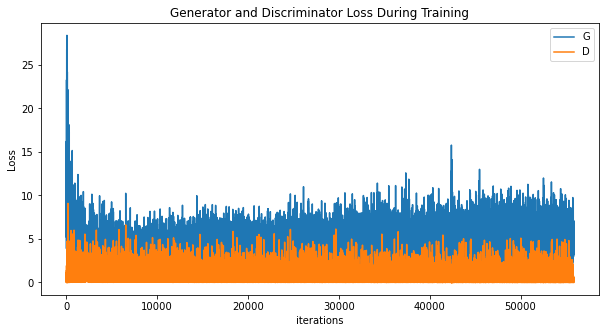

In [191]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21052998 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


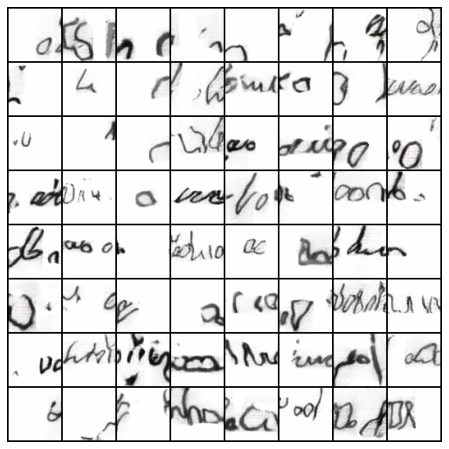

In [192]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

In [200]:
for i in img_list[:1]:
    print(i)

tensor([[[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.5089,  ..., 0.5301, 0.0000, 0.0000],
         ...,
         [0.0000, 0.0000, 0.4946,  ..., 0.5314, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

        [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.4767,  ..., 0.5426, 0.0000, 0.0000],
         ...,
         [0.0000, 0.0000, 0.5280,  ..., 0.5278, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000]],

        [[0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.0000,  ..., 0.0000, 0.0000, 0.0000],
         [0.0000, 0.0000, 0.5886,  ..., 0.4886, 0.0000, 0.

In [206]:
def show(img):
    npimg = img.numpy()
    plt.imshow(np.transpose(npimg, (1,2,0)), interpolation='nearest')

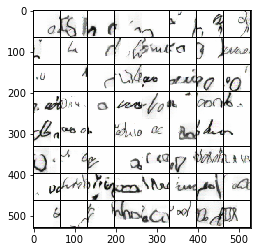

In [210]:
show(img_list[-1])